
<br>


# <span style="color:#5E6997"> Unleashing the Power of Deep Reinforcement Learning for Trading </span>
## <span style="color:#5E6997"> Exploring the Intersection of Reinforcement Learning and Neural Networks </span>


<br>

### **Table of Contents**
* [<span style="color:#A690A4"> 1. Introduction](#intro)
* [<span style="color:#A690A4"> 2. Data Engineering](#data_eng)    
* [<span style="color:#A690A4"> 3. DRL Environment Architecture](#env)
* [<span style="color:#A690A4"> 4. DRL Agent Architecture](#agent)

<br>
    
## <span style="color:#5E6997"> Project Overview </span> <a class="anchor" id="intro"></a>

    
### Introduction
Financial markets are a dynamic, complex ecosystem where traditional trading strategies are continually challenged by evolving market conditions, global events, and intricate patterns that define asset prices. In response to this ever-changing landscape, our team has embarked on a pioneering journey to develop a sophisticated DRL-based algorithmic trading system.

Deep Reinforcement Learning, a subset of artificial intelligence, offers the promise of adaptive, self-improving trading strategies. Inspired by the way humans learn through trial and error, our DRL model navigates financial markets, learning and adapting to new information in real-time, all with the goal of maximizing returns while managing risk.

This project represents a convergence of finance, machine learning, and technology. Our DRL model is designed to make informed trading decisions, considering historical data, market indicators, and other relevant factors, ultimately offering the potential to outperform traditional trading methods. The ability to harness the power of neural networks, paired with reinforcement learning principles, promises a new era in algorithmic trading.

In this project, we will explore the development and implementation of our DRL model, highlighting its capabilities, challenges, and real-world implications in the realm of financial markets. We invite you to journey with us through the intricacies of this innovative approach, where artificial intelligence meets finance, and together, we aim to shape the future of trading.

<br>

### Objective & Scope
- Collect, clean & analyze Bitcoin crypto market data
- Features Engineering
- Build a DRL trading environment
- Train & improve the agent

<br>

### Deep Reinformencement Learning Model

- **Reinforcement Learning Algorithm (RLA):** PPO (Proximal Policy Optimization)

- **Neural Network Architecture for Policy (Agent's action):** MLP Policy (Multi-Layer Perceptron Policy)
    - **Architecture Details:**
        - **Input Layer:** The MLP policy takes observations from the environment as input.
        - **Hidden Layers:** The network typically consists of one or more hidden layers, each containing multiple neurons. The specific number of layers and neurons may vary depending on the complexity of the problem.
        - **Activation Functions:** Each layer in the MLP policy may utilize activation functions like ReLU (Rectified Linear Unit) or Tanh.
        - **Output Layer**: The output layer provides the probabilities or values associated with different actions the agent can take.
    - **Training Process:**
        - The model is trained using PPO, which involves optimizing the policy network to maximize cumulative rewards while ensuring that policy updates are within a safe margin.

<br>
    
Enjoy and looking forward to read your feedback.
    
F.G.J

## <span style="color:#5E6997"> Data Engineering </span> <a class="anchor" id="data_eng"></a>

In [126]:
pip install stable-baselines3

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.3.1 -> 25.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [127]:
pip install 'shimmy>=0.2.1'

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.3.1 -> 25.0
[notice] To update, run: python.exe -m pip install --upgrade pip
ERROR: Invalid requirement: "'shimmy": Expected package name at the start of dependency specifier
    'shimmy
    ^


In [128]:
import pandas as pd
import gym
import numpy as np
from stable_baselines3 import A2C
from stable_baselines3 import DQN
from stable_baselines3 import PPO
from stable_baselines3.common.vec_env import DummyVecEnv
import warnings
warnings.filterwarnings("ignore")

In [129]:
df = pd.read_csv('./newfile.csv')

In [130]:
df.head()

,Date,Adj Close,Close,High,Low,Open,Volume
0,2024-11-18 14:30:00+00:00,226.199997,226.199997,226.410004,225.179993,225.199997,1331036.0
1,2024-11-18 14:31:00+00:00,226.565994,226.565994,226.639999,226.020004,226.220001,276499.0
2,2024-11-18 14:32:00+00:00,226.679993,226.679993,226.880005,226.430099,226.550003,191068.0
3,2024-11-18 14:33:00+00:00,226.410004,226.410004,226.820007,226.110001,226.750000,206426.0
4,2024-11-18 14:34:00+00:00,226.490005,226.490005,226.550003,226.240005,226.369995,131348.0


In [131]:
df.columns

Index(['Date', 'Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')

In [132]:
start_date = '2020-08-17 04:00:00'
end_date = '2023-01-19 23:00:00'

In [133]:
data_df = df.copy(deep=True)

In [134]:
# data_df = data_df[(data_df['token'] == 'ETH') & (data_df['date'] >= start_date) & (data_df['date'] <= end_date)]

In [135]:
data_df.columns

Index(['Date', 'Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')

### Mapping 'day' days to numerical values

In [136]:
# day_mapping = {
#     'Monday': 1,
#     'Tuesday': 2,
#     'Wednesday': 3,
#     'Thursday': 4,
#     'Friday': 5,
#     'Saturday': 6,
#     'Sunday': 7
# }

# data_df['day'] = data_df['day'].apply(lambda x: day_mapping[x])

### Creating new columns EMAs (EMA 13 25 32 100 200)

In [137]:
data_df['ema_13'] = data_df['Close'].ewm(span=13).mean()
data_df['ema_25'] = data_df['Close'].ewm(span=25).mean()
data_df['ema_32'] = data_df['Close'].ewm(span=32).mean()
data_df['ema_100'] = data_df['Close'].ewm(span=100).mean()
data_df['ema_200'] = data_df['Close'].ewm(span=200).mean()

### Creating Candle Volatility Against Price Close (high - low / close)

In [138]:
data_df['vol_close'] = (data_df['High'] - data_df['Low']) / data_df['Close']

### Creating EMA for Candle Volatility/Price 

In [139]:
# EMA for 2 hours (candles)
data_df['vol_close_ema_3'] = data_df['vol_close'].ewm(span=3, adjust=False).mean()

# EMA for 4 hours (candles)
data_df['vol_close_ema_6'] = data_df['vol_close'].ewm(span=6, adjust=False).mean()

# EMA for 8 hours ((candles)
data_df['vol_close_ema_12'] = data_df['vol_close'].ewm(span=12, adjust=False).mean()

In [140]:
data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8372 entries, 0 to 8371
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Date              8372 non-null   object 
 1   Adj Close         8372 non-null   float64
 2   Close             8372 non-null   float64
 3   High              8372 non-null   float64
 4   Low               8372 non-null   float64
 5   Open              8372 non-null   float64
 6   Volume            8372 non-null   float64
 7   ema_13            8372 non-null   float64
 8   ema_25            8372 non-null   float64
 9   ema_32            8372 non-null   float64
 10  ema_100           8372 non-null   float64
 11  ema_200           8372 non-null   float64
 12  vol_close         8372 non-null   float64
 13  vol_close_ema_3   8372 non-null   float64
 14  vol_close_ema_6   8372 non-null   float64
 15  vol_close_ema_12  8372 non-null   float64
dtypes: float64(15), object(1)
memory usage: 1.

In [141]:
data_df['Date'] = pd.to_datetime(data_df['Date'])

In [142]:
# columns_to_drop = ['symbol', 'token']
# data_df = data_df.drop(columns=columns_to_drop)

In [143]:
#data_df = data_df.astype(float)
#data_df.set_index('date', inplace=True)

In [144]:
data_df.to_csv('data_featured.csv', index=False)

In [145]:
train_df = data_df.copy(deep=True)
train_df.reset_index(drop=True, inplace=True)

In [146]:
train_df.head()

,Date,Adj Close,Close,High,Low,Open,Volume,ema_13,ema_25,ema_32,ema_100,ema_200,vol_close,vol_close_ema_3,vol_close_ema_6,vol_close_ema_12
0,2024-11-18 14:30:00+00:00,226.199997,226.199997,226.410004,225.179993,225.199997,1331036.0,226.199997,226.199997,226.199997,226.199997,226.199997,0.005438,0.005438,0.005438,0.005438
1,2024-11-18 14:31:00+00:00,226.565994,226.565994,226.639999,226.020004,226.220001,276499.0,226.397072,226.390316,226.388714,226.384826,226.383911,0.002736,0.004087,0.004666,0.005022
2,2024-11-18 14:32:00+00:00,226.679993,226.679993,226.880005,226.430099,226.550003,191068.0,226.506231,226.494698,226.491937,226.485189,226.483593,0.001985,0.003036,0.003900,0.004555
3,2024-11-18 14:33:00+00:00,226.410004,226.410004,226.820007,226.110001,226.750000,206426.0,226.476361,226.470919,226.469494,226.465825,226.464919,0.003136,0.003086,0.003682,0.004337
4,2024-11-18 14:34:00+00:00,226.490005,226.490005,226.550003,226.240005,226.369995,131348.0,226.479989,226.475370,226.474125,226.470856,226.470037,0.001369,0.002227,0.003021,0.003880


In [147]:
#df_test = data_df[10000:]
#df_test = df_test.reset_index(drop=True)

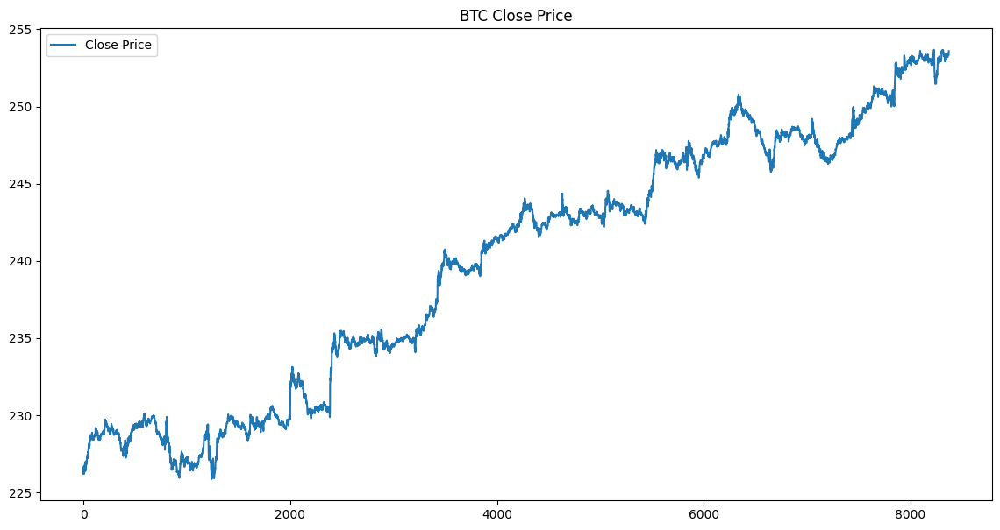

(8372, 16)

In [148]:
# show test data diagram

import matplotlib.pyplot as plt

plt.figure(figsize=(14, 7))
plt.plot(train_df['Close'], label='Close Price')
plt.title('BTC Close Price')
plt.legend()
plt.show()

train_df.shape


## <span style="color:#5E6997"> DRL Environment Architecture </span> <a class="anchor" id="env"></a>

**Environment Controls:**
- **data**: A DataFrame containing the financial data. (passed when called the function 'env' CryptoTradingEnv(data_df))
- **take_profit_range**: A tuple representing the range for take profit levels.
- **stop_loss_range**: A tuple representing the range for stop loss levels.
- **max_stop_loss**: The maximum allowable stop loss.
- **position_size**: The maximum allowable position size.
- **initial_balance**: The initial capital.
- **balance**: Current balance.
- **position**: The current position (0 for no position, 1 for long position).
- **position_open**: The price at which the position was opened.
- **num_trades**: The number of trades.
- **profit_loss**: The cumulative profit/loss.
- **position_size**: The calculated position size as a percentage of the current balance (controlled within the code).
 
 <br>
 
**Obversations:**
- open, high, low, close, volume usdt, hour, day, ema_13, ema_25, ema_32, ema_100, ema_200, vol_close_ema_3, vol_close_ema_6, vol_close_ema_12
 
 <br>
 
**Initial Reward Calculation:**
- When an action is taken, the reward variable is initialized to 0.
- The variable trade_outcome is used to calculate the profit or loss associated with the most recent trade. It is initialized to 0.
 
 <br>
 
**Opening and Closing Trades:**
- If the agent takes the action to open a position (action code 1), and it is not already in a trade (self.position == 0), it calculates the position_size based on the balance or maximum position size, and records the opening price.
- If the agent takes the action to close a position (action code 2), and it is currently in a trade (self.position == 1), it calculates the trade outcome as the difference between the opening price and the current market price.
- The profit_loss is updated with the trade outcome, representing the cumulative profit or loss across all trades.
- The balance is adjusted based on the trade outcome.
 
 <br>
 
**Take Profit and Stop Loss:**
- The code checks whether the trade outcome is greater than 0 (a winning trade) and whether it reaches the take profit level defined by self.take_profit_range.
- If the trade reaches the take profit level (>0), a reward of 0.5 is assigned to indicate a successful trade.
- If the trade is closed within the take profit range, an extra reward of 1 is assigned to indicate a successful trade.
- If the trade outcome is less than 0 (a losing trade), the code checks for two conditions:
- If the trade outcome is egual or exceeds the maximum allowable stop loss (self.max_stop_loss * self.balance), a malus reward of -0.7 is assigned, indicating that the trade reached the maximum stop loss.
- If the trade outcome falls within the stop loss range defined by self.stop_loss_range, a reward of -1 is assigned, indicating that the trade reached the stop loss.
 
 <br>
 
**Trade Outcome Within Range:**
- If trade_within_range is True, it means that the trade outcome fell within the specified take profit range. In this case, self.winning_trade_within_range is incremented to keep track of such trades.
 
 <br>
 
**Cumulative Returns and Episode Tracking:**
- The reward is also added to the episode_returns list to track rewards for the current episode.
- The cumulative_returns is updated with the reward to keep track of cumulative returns.
 
 <br>
 
**Completing an Episode:**
- If the current step reaches the end of the trading data (self.current_step >= self.n_steps), the done flag is set to True, indicating that the episode has ended.

# DRL Environment v1

In [149]:
class CryptoTradingEnv(gym.Env):
    def __init__(self, data, take_profit_position_range=(0.10, 0.80), stop_loss_position_range=(0.00, 0.15), max_stop_loss_position=0.30):
        super(CryptoTradingEnv, self).__init__()

        self.data = data
        self.n_steps = len(data)
        self.current_step = 0
        self.initial_balance = 10000 # Tài khoản giao dịch ban đầu là $10,000.
        self.balance = self.initial_balance # Số dư hiện tại.
        self.position = 0 # Trạng thái lệnh (0 = không có lệnh, 1 = đang giữ lệnh).
        self.position_open = 0 # Price at which the position was opened
        self.num_trades = 0  # Số giao dịch đã thực hiện.
        self.profit_loss = 0  # Tổng lợi nhuận/lỗ.
        self.max_stop_loss_position = max_stop_loss_position # Mức lỗ tối đa.

        self.take_profit_position_range = take_profit_position_range # Ngưỡng chốt lời.
        self.stop_loss_position_range = stop_loss_position_range # Ngưỡng cắt lỗ.

        # 0=Hold, 1=Open Position, 2=Close Position
        self.action_space = gym.spaces.Discrete(3)

        # Observations
        n_features = 13 # 15 đặc trưng (có các chỉ báo kỹ thuật như EMA, Volume, Time).
        self.observation_space = gym.spaces.Box(low=0, high=1, shape=(n_features,))

        self.episode_returns = []  
        self.cumulative_returns = 0 
        self.winning_trades = 0  
        self.losing_trades = 0 
        self.hourly_returns = []
        
        self.overall_rewards = 0


    def step(self, action):
        self.current_step += 1
        done = False
        print(f"Action: {action}")
        reward = 0
        trade_outcome = 0
        trade_within_range = False
        
        # Mở lệnh (action == 1)
            # Kiểm tra nếu không có lệnh đang mở (self.position == 0).
            # Mua coin với 5% số dư tài khoản.
            # Ghi nhận giá mở (self.position_open = self.data.loc[self.current_step, 'open']).
            # Đánh dấu trạng thái giao dịch (self.position = 1).
        
        # Đóng lệnh (action == 2)
            # Nếu đang có lệnh (self.position == 1).
            # Tính toán lợi nhuận/lỗ: trade_outcome = position_close - self.position_open
            # Cập nhật tổng lợi nhuận (self.profit_loss).
            # Đóng (self.position = 0).
        
        # Kiểm tra Take Profit / Stop Loss
            # Nếu lợi nhuận đạt mức chốt lời, nhận phần thưởng +1.
            # Nếu lỗ đạt mức cắt lỗ tối đa (-30%), nhận phần thưởng -1.7.
            # Nếu lỗ trong khoảng (-15%), nhận phần thưởng -1.
        
        # Cập nhật phần thưởng (reward)
            # Thưởng +0.5 nếu giao dịch có lời.
            # Cập nhật tổng điểm thưởng (self.overall_rewards).

        if action == 1:  # Open Position
            if self.position == 0:  # Only open a position if not already in a trade
                position_size = 0.05 * self.balance

                self.position_open = self.data.loc[self.current_step, 'Open']
                self.position = 1
                self.num_trades += 1
                print(f"Opened trade at step {self.current_step} with position size: {position_size:.2f}")
        elif action == 2:  # Close Position
            if self.position == 1:  # Only close a position if currently in a trade
                position_close = self.data.loc[self.current_step, 'Open']
                trade_outcome = position_close - self.position_open
                self.profit_loss += trade_outcome
                self.position = 0
                self.position_open = 0
                print(f"Closed trade at step {self.current_step}")
                print(f"------------------------------> Trade outcome: {trade_outcome}")

                self.balance += trade_outcome
                
                # Check for take profit and stop loss
                if trade_outcome > 0:
                    if trade_outcome >= self.take_profit_position_range[0] * self.position:
                        reward = 1  # Trade reached take profit
                        self.winning_trades += 1  # +1 winning trades count
                        if trade_outcome <= self.take_profit_position_range[1] * self.position and trade_outcome >= self.take_profit_position_range[0] * self.position:
                           # self.trade_within_range = True
                            print("Trade reached take profit")
                elif trade_outcome < 0:
                    if abs(trade_outcome) >= self.max_stop_loss_position * self.position:
                        reward = -1.7  # Trade reached the maximum stop loss
                        self.losing_trades += 1  # +1 losing trades count
                        print("Trade reached the maximum stop loss")
                    elif abs(trade_outcome) >= self.stop_loss_position_range[0] * self.position:
                        reward = -1  # Trade reached the stop loss
                        self.losing_trades += 1  # +1 losing trades count
                        print("Trade reached stop loss")
                    else:
                        # No reward (positive and negative) if the trade closed with no loss
                        reward = 0
                        print("Trade closed with no loss")

#                if trade_within_range:
#                    self.winning_trade_within_range += 1

    # reward based on profit/loss of the last trade
#        reward += trade_outcome
        if trade_outcome > 0:
            reward += 0.5
        print(f"Reward: {reward}")

        # reward for this episode
        self.episode_returns.append(reward)

        # cumulative returns
        self.cumulative_returns += reward

        # hourly returns for daily return calculation
#        self.hourly_returns.append(reward)

        self.overall_rewards += reward  

        if self.current_step >= self.n_steps:
            done = True

        next_state = self.get_observation()
        return next_state, reward, done, {}

    # def updateEnv(self, data): 
        

    def reset(self):
        self.current_step = 0
        self.position = 0
        self.position_open = 0
        episode_return = np.sum(self.episode_returns)
        self.episode_returns = []
        self.cumulative_returns += episode_return
        self.current_week_start = 0
        return self.get_observation()

    def render(self, mode='human'):
        if mode == 'human':
            print(f"Step: {self.current_step}")
            print(f"Open Position: {self.position}")
            print(f"Trades: {self.num_trades} | Profit/Loss: {self.profit_loss:.2f}")
            print(f"Balance: {self.balance:.2f}")
            print(f"Winning Trades: {self.winning_trades} | Losing Trades: {self.losing_trades}")
            print(f"Overall Rewards: {self.overall_rewards:.2f}")
            print(self.data.loc[self.current_step])

    def close(self):
        pass

    def get_observation(self):
        obs = self.data.loc[self.current_step, [
            'Open', 'High', 'Low', 'Close', 'Volume',
            'ema_13', 'ema_25', 'ema_32', 'ema_100', 'ema_200', 'vol_close_ema_3', 'vol_close_ema_6', 'vol_close_ema_12'
        ]].values.astype(np.float32)
        return obs / obs.max()


## <span style="color:#5E6997"> DRL Agent Architecture </span> <a class="anchor" id="agent"></a>

# DRL Agent v1

In [150]:
num_episodes = 5000
print_interval = 100

# split train and test data
train_data = train_df.iloc[:int(0.8 * len(train_df))]
test_data = train_df.iloc[int(0.8 * len(train_df)):]

test_data.reset_index(drop=True, inplace=True)

env = CryptoTradingEnv(train_data)

obs = env.reset()

agent = PPO("MlpPolicy", DummyVecEnv([lambda: env]), verbose=1)

max_steps = 50000 # I was getting error for out of index so i limited the max step

for episode in range(num_episodes):
    obs = np.array(obs, dtype=np.float32)
    action, _ = agent.predict(obs, deterministic=False)

    remaining_steps = min(max_steps - env.current_step, env.n_steps)

    if remaining_steps > 0:
        obs, reward, done, _ = env.step(action)
        env.render()

# #    if done:
# #        obs = env.reset()

    if (episode + 1) % print_interval == 0:
        print(f"Episode {episode + 1}: Final Rewards: {env.cumulative_returns:.2f} | Total Trades: {env.num_trades}")

Using cpu device
Action: 1
Opened trade at step 1 with position size: 500.00
Reward: 0
Step: 1
Open Position: 1
Trades: 1 | Profit/Loss: 0.00
Balance: 10000.00
Winning Trades: 0 | Losing Trades: 0
Overall Rewards: 0.00
Date                2024-11-18 14:31:00+00:00
Adj Close                          226.565994
Close                              226.565994
High                               226.639999
Low                                226.020004
Open                               226.220001
Volume                               276499.0
ema_13                             226.397072
ema_25                             226.390316
ema_32                             226.388714
ema_100                            226.384826
ema_200                            226.383911
vol_close                            0.002736
vol_close_ema_3                      0.004087
vol_close_ema_6                      0.004666
vol_close_ema_12                     0.005022
Name: 1, dtype: object
Action: 1
Reward: 0
St

In [151]:
# %load_ext tensorboard

In [152]:
# %tensorboard --logdir ./ppo_logs/

### Save configuration

In [153]:
agent.save('v1_ppodrl')

## DQN

In [154]:
env = CryptoTradingEnv(train_data)

obs = env.reset()

agentDQN = DQN("MlpPolicy", DummyVecEnv([lambda: env]), verbose=1)

max_steps = 50000 # I was getting error for out of index so i limited the max step

for episode in range(num_episodes):
    obs = np.array(obs, dtype=np.float32)
    action, _ = agent.predict(obs, deterministic=False)

    remaining_steps = min(max_steps - env.current_step, env.n_steps)

    if remaining_steps > 0:
        obs, reward, done, _ = env.step(action)
        env.render()

# #    if done:
# #        obs = env.reset()

    if (episode + 1) % print_interval == 0:
        print(f"Episode {episode + 1}: Final Rewards: {env.cumulative_returns:.2f} | Total Trades: {env.num_trades}")

Using cpu device
Action: 2
Reward: 0
Step: 1
Open Position: 0
Trades: 0 | Profit/Loss: 0.00
Balance: 10000.00
Winning Trades: 0 | Losing Trades: 0
Overall Rewards: 0.00
Date                2024-11-18 14:31:00+00:00
Adj Close                          226.565994
Close                              226.565994
High                               226.639999
Low                                226.020004
Open                               226.220001
Volume                               276499.0
ema_13                             226.397072
ema_25                             226.390316
ema_32                             226.388714
ema_100                            226.384826
ema_200                            226.383911
vol_close                            0.002736
vol_close_ema_3                      0.004087
vol_close_ema_6                      0.004666
vol_close_ema_12                     0.005022
Name: 1, dtype: object
Action: 1
Opened trade at step 2 with position size: 500.00
Reward: 0
St

In [155]:
agent.save('v1_DQNdrl')

## A2C

In [156]:
env = CryptoTradingEnv(train_data)

obs = env.reset()

agentDQN = A2C("MlpPolicy", DummyVecEnv([lambda: env]), verbose=1)

max_steps = 50000 # I was getting error for out of index so i limited the max step

for episode in range(num_episodes):
    obs = np.array(obs, dtype=np.float32)
    action, _ = agent.predict(obs, deterministic=False)

    remaining_steps = min(max_steps - env.current_step, env.n_steps)

    if remaining_steps > 0:
        obs, reward, done, _ = env.step(action)
        env.render()

# #    if done:
# #        obs = env.reset()

    if (episode + 1) % print_interval == 0:
        print(f"Episode {episode + 1}: Final Rewards: {env.cumulative_returns:.2f} | Total Trades: {env.num_trades}")

Using cpu device
Action: 2
Reward: 0
Step: 1
Open Position: 0
Trades: 0 | Profit/Loss: 0.00
Balance: 10000.00
Winning Trades: 0 | Losing Trades: 0
Overall Rewards: 0.00
Date                2024-11-18 14:31:00+00:00
Adj Close                          226.565994
Close                              226.565994
High                               226.639999
Low                                226.020004
Open                               226.220001
Volume                               276499.0
ema_13                             226.397072
ema_25                             226.390316
ema_32                             226.388714
ema_100                            226.384826
ema_200                            226.383911
vol_close                            0.002736
vol_close_ema_3                      0.004087
vol_close_ema_6                      0.004666
vol_close_ema_12                     0.005022
Name: 1, dtype: object
Action: 1
Opened trade at step 2 with position size: 500.00
Reward: 0
St

In [157]:
agent.save('v1_A2Cdrl')

# Test Validation Phase

### Import / load validation data

In [158]:
val_data = train_df

In [159]:
val_data = val_data.reset_index(drop=True)

In [160]:
val_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8372 entries, 0 to 8371
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype              
---  ------            --------------  -----              
 0   Date              8372 non-null   datetime64[ns, UTC]
 1   Adj Close         8372 non-null   float64            
 2   Close             8372 non-null   float64            
 3   High              8372 non-null   float64            
 4   Low               8372 non-null   float64            
 5   Open              8372 non-null   float64            
 6   Volume            8372 non-null   float64            
 7   ema_13            8372 non-null   float64            
 8   ema_25            8372 non-null   float64            
 9   ema_32            8372 non-null   float64            
 10  ema_100           8372 non-null   float64            
 11  ema_200           8372 non-null   float64            
 12  vol_close         8372 non-null   float64            
 13  vol

In [161]:
val_data.head()

,Date,Adj Close,Close,High,Low,Open,Volume,ema_13,ema_25,ema_32,ema_100,ema_200,vol_close,vol_close_ema_3,vol_close_ema_6,vol_close_ema_12
0,2024-11-18 14:30:00+00:00,226.199997,226.199997,226.410004,225.179993,225.199997,1331036.0,226.199997,226.199997,226.199997,226.199997,226.199997,0.005438,0.005438,0.005438,0.005438
1,2024-11-18 14:31:00+00:00,226.565994,226.565994,226.639999,226.020004,226.220001,276499.0,226.397072,226.390316,226.388714,226.384826,226.383911,0.002736,0.004087,0.004666,0.005022
2,2024-11-18 14:32:00+00:00,226.679993,226.679993,226.880005,226.430099,226.550003,191068.0,226.506231,226.494698,226.491937,226.485189,226.483593,0.001985,0.003036,0.003900,0.004555
3,2024-11-18 14:33:00+00:00,226.410004,226.410004,226.820007,226.110001,226.750000,206426.0,226.476361,226.470919,226.469494,226.465825,226.464919,0.003136,0.003086,0.003682,0.004337
4,2024-11-18 14:34:00+00:00,226.490005,226.490005,226.550003,226.240005,226.369995,131348.0,226.479989,226.475370,226.474125,226.470856,226.470037,0.001369,0.002227,0.003021,0.003880


In [162]:
pre_trained_PPOagent = PPO.load('v1_ppodrl')
pre_trained_DQNagent = PPO.load('v1_ppodrl')
pre_trained_A2Cagent = PPO.load('v1_ppodrl')

In [163]:
# # Test trained model
# pre_trained_agent = PPO.load('v1_ppodrl')

# env_a = CryptoTradingEnv(val_data)

# obs = env.reset()

# for episode in range(len(test_data)):
#     obs = np.array(obs, dtype=np.float32)
#     action, _ = pre_trained_agent.predict(obs, deterministic=True)
#     obs, reward, done, _ = env.step(action)
#     env_a.render()

#     if (episode + 1) % print_interval == 0:
#         print(f"Episode {episode + 1}: Final Rewards: {env_a.cumulative_returns:.2f} | Total Trades: {env_a.num_trades}")


In [164]:
# # Test base on pre-trained model
# # num_episodes = 10000

# env_test = CryptoTradingEnv(test_data)

# obs = env.reset()

# for episode in range(num_episodes):
#   obs = np.array(obs, dtype=np.float32)
#   action, _ = pre_trained_agent.predict(obs, deterministic=True)
#   obs, reward, done, _ = env.step(action)
#   env.render()

#   if (episode + 1) % print_interval == 0:
#     print(f"Episode {episode + 1}: Final Rewards: {env_test.cumulative_returns:.2f} | Total Trades: {env_test.num_trades}")

In [165]:
env_test = CryptoTradingEnv(test_data)
obs = env_test.reset()

num_episodes = 1000

for episode in range(num_episodes):
    obs = np.array(obs, dtype=np.float32)
    action, _ = pre_trained_PPOagent.predict(obs, deterministic=True) 
    obs, reward, done, _ = env_test.step(action)
    env_test.render()

    # remaining_steps = min(max_steps - env_test.current_step, env_test.n_steps)

    # if remaining_steps > 0:
    #     obs, reward, done, _ = env_test.step(action)
    #     env_test.render()

    if (episode + 1) % 1000 == 0:
        print(f"Episode {episode + 1}: Final Rewards: {env_test.cumulative_returns:.2f} | Total Trades: {env_test.num_trades}")

Action: 0


Reward: 0
Step: 1
Open Position: 0
Trades: 0 | Profit/Loss: 0.00
Balance: 10000.00
Winning Trades: 0 | Losing Trades: 0
Overall Rewards: 0.00
Date                2024-12-12 15:31:00+00:00
Adj Close                          248.027802
Close                              248.027802
High                               248.184998
Low                                248.009995
Open                               248.175003
Volume                                76926.0
ema_13                             247.768585
ema_25                             247.435339
ema_32                             247.295929
ema_100                            247.011902
ema_200                            247.364257
vol_close                            0.000706
vol_close_ema_3                      0.000804
vol_close_ema_6                      0.000823
vol_close_ema_12                     0.000811
Name: 1, dtype: object
Action: 0
Reward: 0
Step: 2
Open Position: 0
Trades: 0 | Profit/Loss: 0.00
Balance: 10000.00
Winni

In [166]:
env_test = CryptoTradingEnv(test_data)
obs = env_test.reset()

num_episodes = 1000

for episode in range(num_episodes):
    obs = np.array(obs, dtype=np.float32)
    action, _ = pre_trained_DQNagent.predict(obs, deterministic=True) 
    obs, reward, done, _ = env_test.step(action)
    env_test.render()

    # remaining_steps = min(max_steps - env_test.current_step, env_test.n_steps)

    # if remaining_steps > 0:
    #     obs, reward, done, _ = env_test.step(action)
    #     env_test.render()

    if (episode + 1) % 1000 == 0:
        print(f"Episode {episode + 1}: Final Rewards: {env_test.cumulative_returns:.2f} | Total Trades: {env_test.num_trades}")

Action: 0
Reward: 0
Step: 1
Open Position: 0
Trades: 0 | Profit/Loss: 0.00
Balance: 10000.00
Winning Trades: 0 | Losing Trades: 0
Overall Rewards: 0.00
Date                2024-12-12 15:31:00+00:00
Adj Close                          248.027802
Close                              248.027802
High                               248.184998
Low                                248.009995
Open                               248.175003
Volume                                76926.0
ema_13                             247.768585
ema_25                             247.435339
ema_32                             247.295929
ema_100                            247.011902
ema_200                            247.364257
vol_close                            0.000706
vol_close_ema_3                      0.000804
vol_close_ema_6                      0.000823
vol_close_ema_12                     0.000811
Name: 1, dtype: object
Action: 0
Reward: 0
Step: 2
Open Position: 0
Trades: 0 | Profit/Loss: 0.00
Balance: 10000

In [167]:
env_test = CryptoTradingEnv(test_data)
obs = env_test.reset()

num_episodes = 1000

for episode in range(num_episodes):
    obs = np.array(obs, dtype=np.float32)
    action, _ = pre_trained_A2Cagent.predict(obs, deterministic=True) 
    obs, reward, done, _ = env_test.step(action)
    env_test.render()

    # remaining_steps = min(max_steps - env_test.current_step, env_test.n_steps)

    # if remaining_steps > 0:
    #     obs, reward, done, _ = env_test.step(action)
    #     env_test.render()

    if (episode + 1) % 1000 == 0:
        print(f"Episode {episode + 1}: Final Rewards: {env_test.cumulative_returns:.2f} | Total Trades: {env_test.num_trades}")

Action: 0
Reward: 0
Step: 1
Open Position: 0
Trades: 0 | Profit/Loss: 0.00
Balance: 10000.00
Winning Trades: 0 | Losing Trades: 0
Overall Rewards: 0.00
Date                2024-12-12 15:31:00+00:00
Adj Close                          248.027802
Close                              248.027802
High                               248.184998
Low                                248.009995
Open                               248.175003
Volume                                76926.0
ema_13                             247.768585
ema_25                             247.435339
ema_32                             247.295929
ema_100                            247.011902
ema_200                            247.364257
vol_close                            0.000706
vol_close_ema_3                      0.000804
vol_close_ema_6                      0.000823
vol_close_ema_12                     0.000811
Name: 1, dtype: object
Action: 0
Reward: 0
Step: 2
Open Position: 0
Trades: 0 | Profit/Loss: 0.00
Balance: 10000

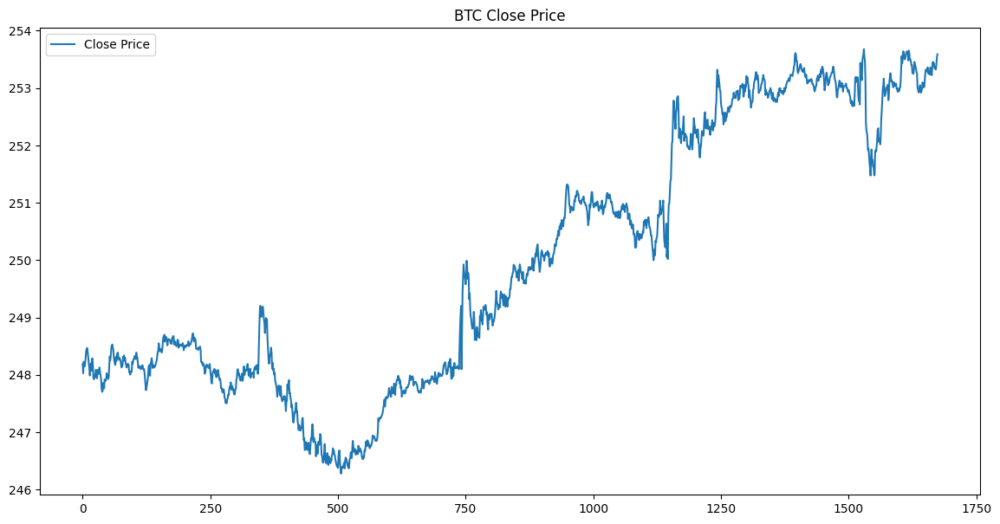

In [168]:
# show test data diagram

import matplotlib.pyplot as plt

plt.figure(figsize=(14, 7))
plt.plot(test_data['Close'], label='Close Price')
plt.title('BTC Close Price')
plt.legend()
plt.show()


### Thank you for taking the time to go through my notebook

Chương: 
- 1000 episodes test 1 lần để coi nó thông minh hơn mỗi lần sao -> ghi lại kq
- Thử các thuật toán khác ngoài ppo -> ghi lại kết quả so sánh
- Tách train test ra
- Improve actions/env (cái này ko cần ưu tiên, ưu tiên 3 cái trên cho xong đi)

Sang:
- Đọc hiểu paper, các khái niệm
- Cài đặt chạy code của paper